# Example usage of `risknyield` package
This notebook contains a minimal example for simulating crop evolution.

## Imports

In [ ]:
from __future__ import annotations

from pathlib import Path
from pprint import pprint
from typing import Any, Dict, Tuple, Optional
from datetime import datetime

import numpy as np
import pandas as pd
from scipy.io import loadmat
import h5py

# NEW API
from risknyield.core.crops import CropParams
from risknyield.core.data_containers import Weather, Soil
from risknyield.core.model import CropModel

from risknyield.library.io_hdf5 import save_results_hdf5

Array = np.ndarray

## Inputs Loading Helpers

In [ ]:
# Local paths
try:
    HERE = Path(__file__).resolve().parent  # scripts
except NameError:
    HERE = Path.cwd()                        # notebooks

BASE = HERE.parent  # adjust as needed
DATA_PATH = BASE / "data"
WEATHER_CSV_PATH = DATA_PATH / "Weather" / "weather.csv"
SOIL_MAT_PATH = DATA_PATH / "Soil"
OUT_PATH = BASE / "examples" / "outputs"
OUT_PATH.mkdir(parents=True, exist_ok=True)


# ================================================
# Helper functions for HDF5 persistence for inputs
# ================================================

def _suggest_chunks(shape: tuple[int, ...]) -> Optional[tuple[int, ...]]:
    """Chunk 2D arrays for spatial access; 1D leave contiguous."""
    if len(shape) == 2:
        H, W = shape
        return (min(H, 128), min(W, 128))
    return None


def _write_ds(g: h5py.Group, name: str, arr: np.ndarray) -> None:
    arr = np.asarray(arr)
    dset = g.create_dataset(
        name,
        data=arr,
        compression="gzip",
        compression_opts=4,
        shuffle=True,
        chunks=_suggest_chunks(arr.shape),
    )
    dset.attrs["shape"] = arr.shape
    dset.attrs["dtype"] = str(arr.dtype)


def save_inputs_hdf5(
    path: Path,
    *,
    crop_mask: np.ndarray,
    lat: np.ndarray,
    lon: np.ndarray,
    dds0: np.ndarray,
    water0: np.ndarray,
    temp: np.ndarray,
    par: np.ndarray,
    precip: np.ndarray,
    et0: np.ndarray,
    start_date: datetime,
    end_date: datetime,
    extra_meta: Optional[Dict[str, Any]] = None,
) -> None:
    """
    Persist the *inputs* required to re-run the scenario, decoupled from examples/.
    Produces an inputs snapshot with groups:
      /soil/{crop_mask,lat,lon,dds0,water0}
      /weather/{temp,par,precip,et0}
    File attributes record start/end dates as ISO strings.
    """
    path = Path(path)
    path.parent.mkdir(parents=True, exist_ok=True)
    with h5py.File(path, "w") as f:
        f.attrs["schema"] = "risknyield.inputs/2"
        f.attrs["start_date"] = start_date.strftime("%Y-%m-%d")
        f.attrs["end_date"] = end_date.strftime("%Y-%m-%d")
        if extra_meta:
            for k, v in extra_meta.items():
                f.attrs[k] = str(v)

        g_soil = f.create_group("soil")
        _write_ds(g_soil, "crop_mask", crop_mask.astype(bool))
        _write_ds(g_soil, "lat", lat)
        _write_ds(g_soil, "lon", lon)
        _write_ds(g_soil, "dds0", dds0)
        _write_ds(g_soil, "water0", water0)

        g_weather = f.create_group("weather")
        _write_ds(g_weather, "temp", temp)
        _write_ds(g_weather, "par", par)
        _write_ds(g_weather, "precip", precip)
        _write_ds(g_weather, "et0", et0)

    print(f"[ok] Wrote inputs snapshot: {path.resolve()}")


# -----------------------------
# Utility helpers
# -----------------------------
def load_matlab_file_as_dict(filename: str, verbose=False) -> Dict[str, Any]:
    loaded_dict: Dict[str, Any] = loadmat(Path(SOIL_MAT_PATH, filename))
    if verbose:
        pprint(loaded_dict.keys())
    return loaded_dict


def load_weather(
    path: Path, start_date: datetime, end_date: datetime
) -> pd.DataFrame:
    df = pd.read_csv(path)
    df["FECHA"] = pd.to_datetime(df["FECHA"], format="%Y-%m-%d")
    df.rename(
        columns={
            "FECHA": "scene_date",
            "TMPMED": "temp",
            "RAD": "par",
            "PREC": "precip",
            "ET0": "et0",
        },
        inplace=True,
    )
    cols = ["scene_date", "temp", "par", "precip", "et0"]
    df = df.loc[
        (df["scene_date"] >= start_date) & (df["scene_date"] <= end_date),
        cols,
    ]
    return df


# -----------------------------
# Loaders
# -----------------------------
def load_soil_from_data() -> Tuple[Array, Array, Array, Array, Array]:
    """Return (mask_maize, lat, lon, dds0, water0) from example .mat files."""
    mask_maize: Array = load_matlab_file_as_dict("mat_maiz_2021_lowres.mat")[
        "clase_maiz_2021_lowres"
    ]
    lat: Array = load_matlab_file_as_dict("mat_maiz_2021_lat_lowres.mat")[
        "lat_lowres"
    ]
    lon: Array = load_matlab_file_as_dict("mat_maiz_2021_lon_lowres.mat")[
        "lon_lowres"
    ]
    dds0: Array = load_matlab_file_as_dict("mat_dds_maiz_est_lowres.mat")[
        "dds_est"
    ]
    water0: Array = (
        load_matlab_file_as_dict("mat_aguadisp_saocom_maiz_2021-2022_2.mat")[
            "a_disp_campo"
        ]
    )  # mm
    return (mask_maize, lat, lon, dds0, water0)


def load_weather_from_data(
    data_path: Path, start_time: datetime, end_time: datetime
) -> Tuple[Array, Array, Array, Array]:
    df_weather: pd.DataFrame = load_weather(data_path, start_time, end_time)
    temp, par, precip, et0 = (
        df_weather["temp"].to_numpy(),
        df_weather["par"].to_numpy(),
        df_weather["precip"].to_numpy(),
        df_weather["et0"].to_numpy(),
    )
    return temp, par, precip, et0



## Instantiating objects from input data

In [ ]:
# -----------------------------
# Set parameters from data files
# -----------------------------
if __name__ == "__main__":
    start_date = datetime(2021, 12, 4)
    end_date = datetime(2022, 6, 2)

    mask_maize, lat, lon, dds0, water0 = load_soil_from_data()
    temp, par, precip, et0 = load_weather_from_data(
        WEATHER_CSV_PATH, start_date, end_date
    )

    # -----------------------------
    # Initialize Weather & Soil
    # -----------------------------
    weather = Weather(temp=temp, par=par, precip=precip, et0=et0)

    target_crop = "maize"  # or "soy" if you like
    crop_mask = mask_maize.astype(bool)

    soil = Soil(
        lat=lat,
        lon=lon,
        water0=water0,
        dds0=dds0,
        crop_mask=crop_mask,
        # n_layers, cc, pmp, soil_layer_depth_mm keep defaults unless you want to override
    )



## Running Model

In [5]:
    # -----------------------------
    # Run simulation with new API
    # -----------------------------
    params = CropParams.from_preset(target_crop)  # CropParams.maize() works too
    model = CropModel(soil=soil, weather=weather, params=params)
    results = model.evolve()

## Plotting Results

(278, 358, 181)
0.0 3966.2095937501254


Animation size has reached 21209866 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


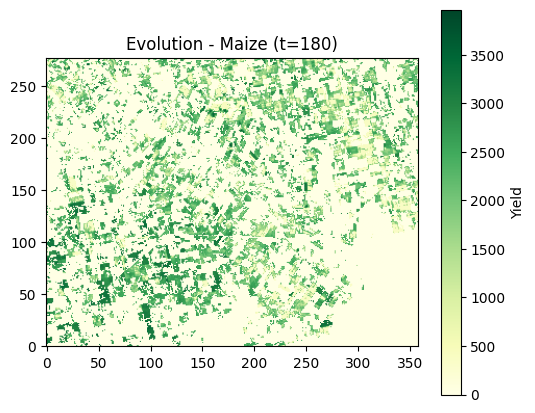

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
from IPython.display import HTML

rc("animation", html="jshtml")  # clave para que se renderice en la celda

data = results.biomass_cum  # (nx, ny, T)
print(data.shape)
T = data.shape[-1]

vmin = np.nanmin(data)
vmax = np.nanmax(data)
print(vmin, vmax)

fig, ax = plt.subplots(figsize=(6, 5))
im = ax.imshow(
    data[:, :, 0], origin="lower", vmin=vmin, vmax=vmax, cmap="YlGn"
)
cbar = plt.colorbar(im, ax=ax, label="Yield")
ax.set_title("Yield evolution - Maize (t=0)")


def update(t):
    im.set_array(data[:, :, t])
    ax.set_title(f"Evolution - Maize (t={t})")
    return [im]


ani = animation.FuncAnimation(fig, update, frames=T, interval=180, blit=True)

HTML(ani.to_jshtml())

## Saving Results

In [ ]:

    # -----------------------------
    # Save results + (optionally) inputs snapshot
    # -----------------------------
    out_results = OUT_PATH / f"sim_{target_crop}.h5"
    save_results_hdf5(results, out_results)
    print(f"[ok] Saved results: {out_results.resolve()}")

    # Optional: persist inputs to rerun this scenario later
    out_inputs = OUT_PATH / f"inputs_{target_crop}.h5"
    save_inputs_hdf5(
        out_inputs,
        crop_mask=crop_mask,
        lat=lat,
        lon=lon,
        dds0=dds0,
        water0=water0,
        temp=temp,
        par=par,
        precip=precip,
        et0=et0,
        start_date=start_date,
        end_date=end_date,
        extra_meta={"example": "run_simulation.py"},
    )
    print(f"[ok] Saved inputs:  {out_inputs.resolve()}")